This notebook contains a basic overview of a multimodal workflow in current (master branch) scanpy

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd

import seaborn as sns

# Reading in multimodal data is pretty easy

In [2]:
# !mkdir -p data
# !wget http://cf.10xgenomics.com/samples/cell-exp/3.1.0/5k_pbmc_protein_v3_nextgem/5k_pbmc_protein_v3_nextgem_filtered_feature_bc_matrix.h5 -O data/5k_pbmc_protein_v3_nextgem_filtered_feature_bc_matrix.h5

In [3]:
DATAFILE = "data/5k_pbmc_protein_v3_nextgem_filtered_feature_bc_matrix.h5"

In [4]:
pbmc = sc.read_10x_h5(DATAFILE, gex_only=False)
pbmc

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 5527 × 33570 
    var: 'gene_ids', 'feature_types', 'genome'

## Preprocessing and normalization

Split into protein and gene objects:

In [5]:
protein = pbmc[:, pbmc.var["genome"] == ""].copy()
genes = pbmc[:, pbmc.var["genome"] != ""].copy()

genes.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


### Protein

In [6]:
protein.var["control"] = protein.var_names.str.contains("control")

In [7]:
sc.pp.calculate_qc_metrics(
    protein,
    percent_top=(5, 10, 15),
    var_type="antibodies",
    qc_vars=("control",),
    inplace=True,
)

 We can look at qc stuff:

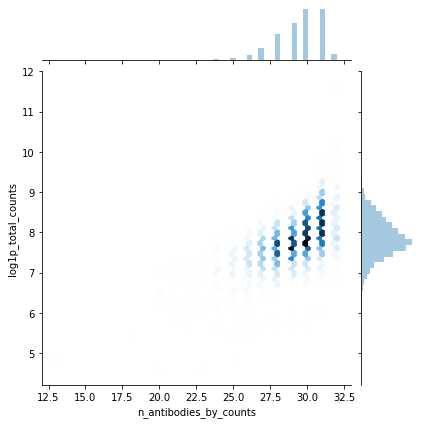

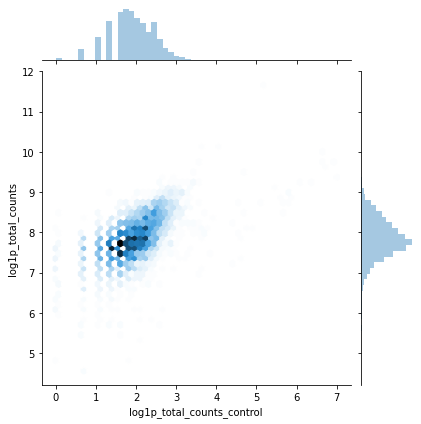

In [8]:
sns.jointplot("n_antibodies_by_counts", "log1p_total_counts", protein.obs, kind="hex")
sns.jointplot("log1p_total_counts_control", "log1p_total_counts", protein.obs, kind="hex")

In [9]:
protein.layers["counts"] = protein.X.copy()

In [10]:
sc.pp.normalize_total(protein)
sc.pp.log1p(protein)

In [11]:
protein.n_vars

32

In [12]:
sc.pp.pca(protein, n_comps=20)
sc.pp.neighbors(protein, use_rep="X", metric="cosine")  # There's only 32 antibodies, so might as well
sc.tl.umap(protein)
sc.tl.leiden(protein)

/usr/local/lib/python3.7/site-packages/pynndescent/rp_trees.py:791: NumbaTypeSafetyWarning: unsafe cast from uint32 to int32. Precision may be lost.
  leaf_size,


... storing 'feature_types' as categorical
... storing 'genome' as categorical


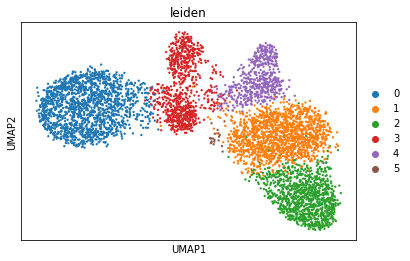

In [13]:
sc.pl.umap(protein, color="leiden")

### RNA

Preprocess

In [14]:
genes.var["mito"] = genes.var_names.str.startswith("MT-")

In [15]:
sc.pp.filter_genes(genes, min_counts=1)
sc.pp.calculate_qc_metrics(genes, qc_vars=["mito"], inplace=True)

In [16]:
# Cache counts
genes.layers["counts"] = genes.X.copy()

In [17]:
sc.pp.normalize_total(genes)
sc.pp.log1p(genes)

In [18]:
sc.pp.pca(genes)
sc.pp.neighbors(genes, n_neighbors=30)
sc.tl.umap(genes)
sc.tl.leiden(genes)

# Joining the data and doing some plotting

In [19]:
genes.obsm["protein"] = protein.to_df()
genes.obsm["protein_umap"] = protein.obsm["X_umap"]
genes.obs["protein_leiden"] = protein.obs["leiden"]

The clusterings disagree quite a bit, so we can tell that we are missing some information:

... storing 'feature_types' as categorical
... storing 'genome' as categorical


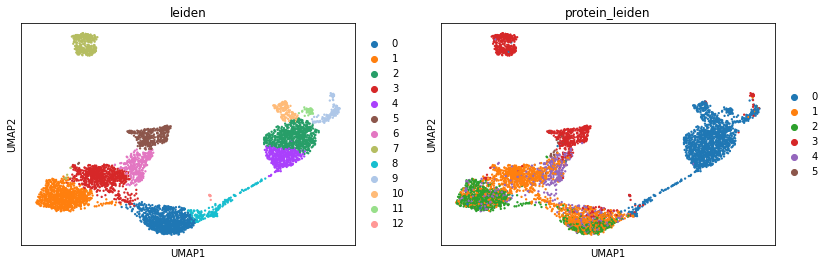

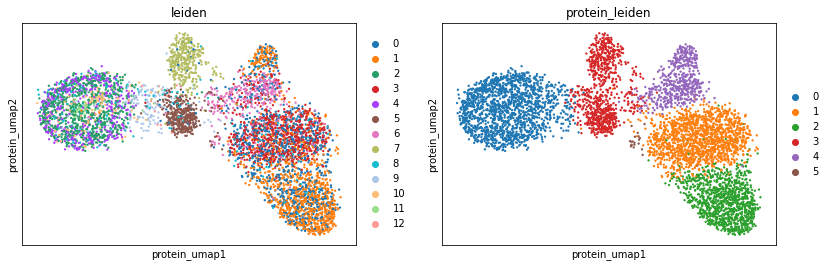

In [20]:
sc.pl.umap(genes, color=["leiden", "protein_leiden"])
sc.pl.embedding(genes, basis="protein_umap", color=["leiden", "protein_leiden"])

In [21]:
import plotly
from plotly import express as px

In [22]:
plotly.io.templates.default = "plotly_white"

Now we can plot protein expression on the rna plot. This just needs obsm keys to work with `sc.pl.embedding` before we can do it there.

In [23]:
(
    px.scatter(
        sc.get.obs_df(
            genes, 
            obsm_keys=[("X_umap", 0), ("X_umap", 1)] + [("protein", i) for i in protein.var_names]
        ).melt(id_vars=["X_umap-0", "X_umap-1"]),
        x="X_umap-0", y="X_umap-1", 
        color="value", facet_col="variable",
        facet_col_wrap=5,
        height=1200,
    )
    .update_traces(marker_size=1)
)

# Integration ideas

## Joint clustering

So far I've only gotten okay results from this, but also haven't followed up on it much:

In [24]:
import leidenalg as la

In [25]:
protein_graph = sc._utils.get_igraph_from_adjacency(protein.uns["neighbors"]["connectivities"])
genes_graph = sc._utils.get_igraph_from_adjacency(genes.uns["neighbors"]["connectivities"])

In [26]:
%%time
part, _ = la.find_partition_multiplex(
    [
        protein_graph,
        genes_graph
    ],
    la.RBERVertexPartition,
    weights="weight"
)

CPU times: user 601 ms, sys: 3.93 ms, total: 605 ms
Wall time: 603 ms


In [27]:
genes.obs["joint_leiden"] = np.array(part).astype(str)

As you can see, looks only okay. I think it'd be worth doing some feature selection as well as doublet removal and trying again.

... storing 'joint_leiden' as categorical


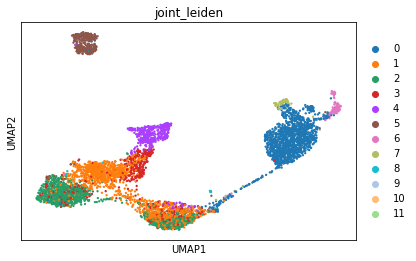

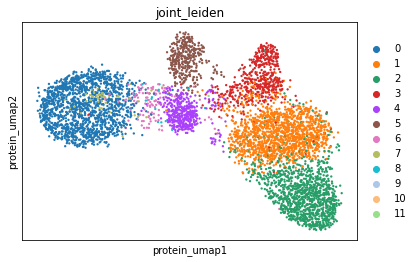

In [28]:
sc.pl.umap(genes, color="joint_leiden")
sc.pl.embedding(genes, basis="protein_umap", color="joint_leiden")

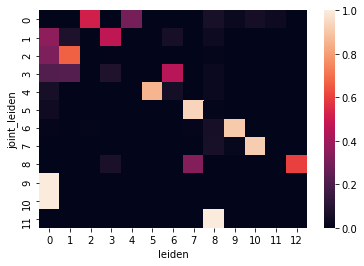

In [29]:
sns.heatmap(pd.crosstab(genes.obs["joint_leiden"], genes.obs["leiden"], normalize="index"))

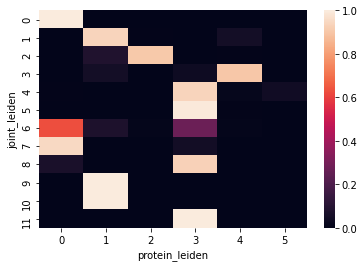

In [30]:
sns.heatmap(pd.crosstab(genes.obs["joint_leiden"], genes.obs["protein_leiden"], normalize="index"))